<a href="https://www.kaggle.com/code/lubomirk/house-prices?scriptVersionId=127041577" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [324]:

import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import KNNImputer
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from lightgbm import LGBMRegressor


# reading data + exploration

In [325]:
data = pd.read_csv("/kaggle/input/house-prices-advanced-regression-techniques/train.csv")
def missing_val_detector(data):
    
    print(f"Shape of the df : {data.shape}")
    print(data.describe())
    missing_value_column = {}
    # check how many NaN are in each column
    for i in data.columns:
        missing = sum(data[i].isna())
        if missing > 0:
            print("\n")
            print(f"the number of missing values of column {i} :  {missing}")
            missing_value_column[i] = missing
    missing_value_column = dict(sorted(missing_value_column.items(), key=lambda item: -item[1]))

    missing_columns = pd.Series(missing_value_column.keys())
    vals = np.fromiter(missing_value_column.values(), dtype=float)
    prop_missing = vals/data.shape[0] # make proportion of missing values 
    # Plot figure of missing values
    plt.figure(figsize = (16,8))
    plt.bar(missing_columns,prop_missing)
    plt.xticks(rotation =60)
    plt.show()
    return(missing_columns,prop_missing)

<font size="5">Exploration of the columns. Here we try to figure out what are the missing values, if we can soemhow fix them, or we have to delete either rows or columns to keep only valid data. Let' try doing so that we loos as little data s possible</font>


Shape of the df : (1460, 81)
                Id   MSSubClass  LotFrontage        LotArea  OverallQual  \
count  1460.000000  1460.000000  1201.000000    1460.000000  1460.000000   
mean    730.500000    56.897260    70.049958   10516.828082     6.099315   
std     421.610009    42.300571    24.284752    9981.264932     1.382997   
min       1.000000    20.000000    21.000000    1300.000000     1.000000   
25%     365.750000    20.000000    59.000000    7553.500000     5.000000   
50%     730.500000    50.000000    69.000000    9478.500000     6.000000   
75%    1095.250000    70.000000    80.000000   11601.500000     7.000000   
max    1460.000000   190.000000   313.000000  215245.000000    10.000000   

       OverallCond    YearBuilt  YearRemodAdd   MasVnrArea   BsmtFinSF1  ...  \
count  1460.000000  1460.000000   1460.000000  1452.000000  1460.000000  ...   
mean      5.575342  1971.267808   1984.865753   103.685262   443.639726  ...   
std       1.112799    30.202904     20.645407 

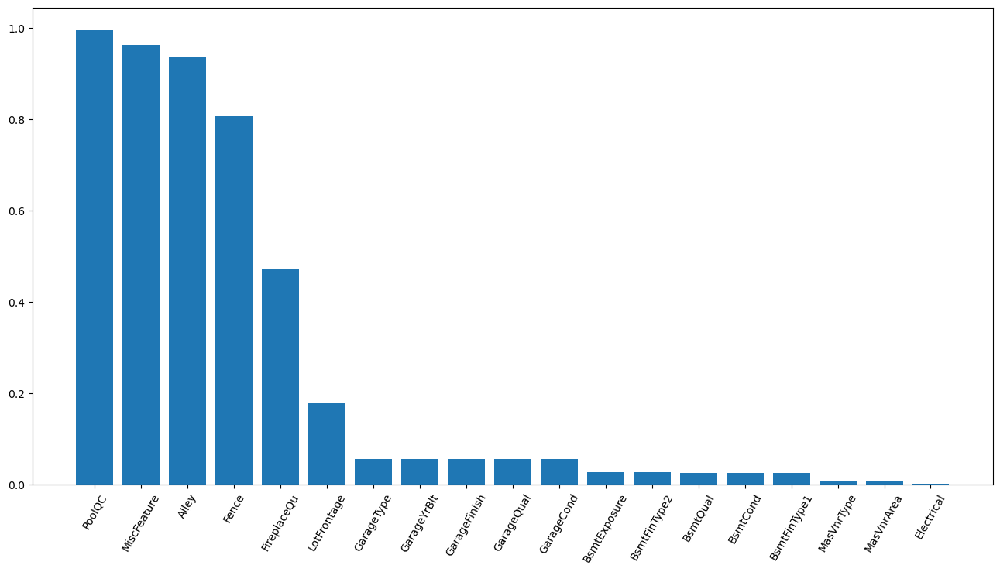

In [326]:

missing_columns, prop_missing = missing_val_detector(data)

<font size="5">Let's look at the columns with close to 100% missing values
</font>


# Handling missing values

In [327]:
cols = missing_columns[:4]
print(data[cols])

     PoolQC MiscFeature Alley  Fence
0       NaN         NaN   NaN    NaN
1       NaN         NaN   NaN    NaN
2       NaN         NaN   NaN    NaN
3       NaN         NaN   NaN    NaN
4       NaN         NaN   NaN    NaN
...     ...         ...   ...    ...
1455    NaN         NaN   NaN    NaN
1456    NaN         NaN   NaN  MnPrv
1457    NaN        Shed   NaN  GdPrv
1458    NaN         NaN   NaN    NaN
1459    NaN         NaN   NaN    NaN

[1460 rows x 4 columns]



<font size="5">We definitely cannot impute this values so the columns will have to be removed. As for the columns with missing value proportion higher than 10% we can have a look at them. Most likely those columns will be removed as well

</font>

In [328]:
# looking at the columns with over 10% missing values
over10_missing = missing_columns[prop_missing>0.1]
data[over10_missing]

,PoolQC,MiscFeature,Alley,Fence,FireplaceQu,LotFrontage
0,NaN,NaN,NaN,NaN,NaN,65.0
1,NaN,NaN,NaN,NaN,TA,80.0
2,NaN,NaN,NaN,NaN,TA,68.0
3,NaN,NaN,NaN,NaN,Gd,60.0
4,NaN,NaN,NaN,NaN,TA,84.0
...,...,...,...,...,...,...
1455,NaN,NaN,NaN,NaN,TA,62.0
1456,NaN,NaN,NaN,MnPrv,TA,85.0
1457,NaN,Shed,NaN,GdPrv,Gd,66.0
1458,NaN,NaN,NaN,NaN,NaN,68.0




<font size="5">We can notice one of the columns with high missing value is Fireplace Quality - it would be a good idea to look if the houses with the NaN as a value have fireplace. If not we can just recode NaN value into "no_fireplace" to preserve this variable 

</font>

In [329]:
fireplaces = data[["FireplaceQu","Fireplaces"]].copy(deep=True)
print(fireplaces.groupby("FireplaceQu").describe())
print(fireplaces.loc[fireplaces["FireplaceQu"].isna()].describe())

            Fireplaces                                             
                 count      mean       std  min  25%  50%  75%  max
FireplaceQu                                                        
Ex                24.0  1.250000  0.531610  1.0  1.0  1.0  1.0  3.0
Fa                33.0  1.181818  0.464660  1.0  1.0  1.0  1.0  3.0
Gd               380.0  1.152632  0.374474  1.0  1.0  1.0  1.0  3.0
Po                20.0  1.000000  0.000000  1.0  1.0  1.0  1.0  1.0
TA               313.0  1.175719  0.389508  1.0  1.0  1.0  1.0  3.0
       Fireplaces
count       690.0
mean          0.0
std           0.0
min           0.0
25%           0.0
50%           0.0
75%           0.0
max           0.0



<font size="5">
This means we can try recoding the NaN to valid values

</font>

In [330]:
data["FireplaceQu"].loc[data["FireplaceQu"].isna()] =  "no"

/opt/conda/lib/python3.7/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [331]:
print(data[["FireplaceQu","Fireplaces"]].groupby("FireplaceQu").describe())
print(data[["FireplaceQu","Fireplaces"]])

            Fireplaces                                             
                 count      mean       std  min  25%  50%  75%  max
FireplaceQu                                                        
Ex                24.0  1.250000  0.531610  1.0  1.0  1.0  1.0  3.0
Fa                33.0  1.181818  0.464660  1.0  1.0  1.0  1.0  3.0
Gd               380.0  1.152632  0.374474  1.0  1.0  1.0  1.0  3.0
Po                20.0  1.000000  0.000000  1.0  1.0  1.0  1.0  1.0
TA               313.0  1.175719  0.389508  1.0  1.0  1.0  1.0  3.0
no               690.0  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0
     FireplaceQu  Fireplaces
0             no           0
1             TA           1
2             TA           1
3             Gd           1
4             TA           1
...          ...         ...
1455          TA           1
1456          TA           2
1457          Gd           2
1458          no           0
1459          no           0

[1460 rows x 2 columns]



<font size="5">
Now we can proceed with removing the columns

</font>

In [332]:

over10_missing = over10_missing[over10_missing!="FireplaceQu"]
valid_columns = list(set(data.columns)- set(over10_missing))
intermediate_df = data[valid_columns]

Shape of the df : (1460, 76)
          HalfBath    GrLivArea           Id  OverallCond   BsmtFinSF2  \
count  1460.000000  1460.000000  1460.000000  1460.000000  1460.000000   
mean      0.382877  1515.463699   730.500000     5.575342    46.549315   
std       0.502885   525.480383   421.610009     1.112799   161.319273   
min       0.000000   334.000000     1.000000     1.000000     0.000000   
25%       0.000000  1129.500000   365.750000     5.000000     0.000000   
50%       0.000000  1464.000000   730.500000     5.000000     0.000000   
75%       1.000000  1776.750000  1095.250000     6.000000     0.000000   
max       2.000000  5642.000000  1460.000000     9.000000  1474.000000   

        WoodDeckSF  BsmtHalfBath   BsmtFinSF1   GarageCars     FullBath  ...  \
count  1460.000000   1460.000000  1460.000000  1460.000000  1460.000000  ...   
mean     94.244521      0.057534   443.639726     1.767123     1.565068  ...   
std     125.338794      0.238753   456.098091     0.747315     0

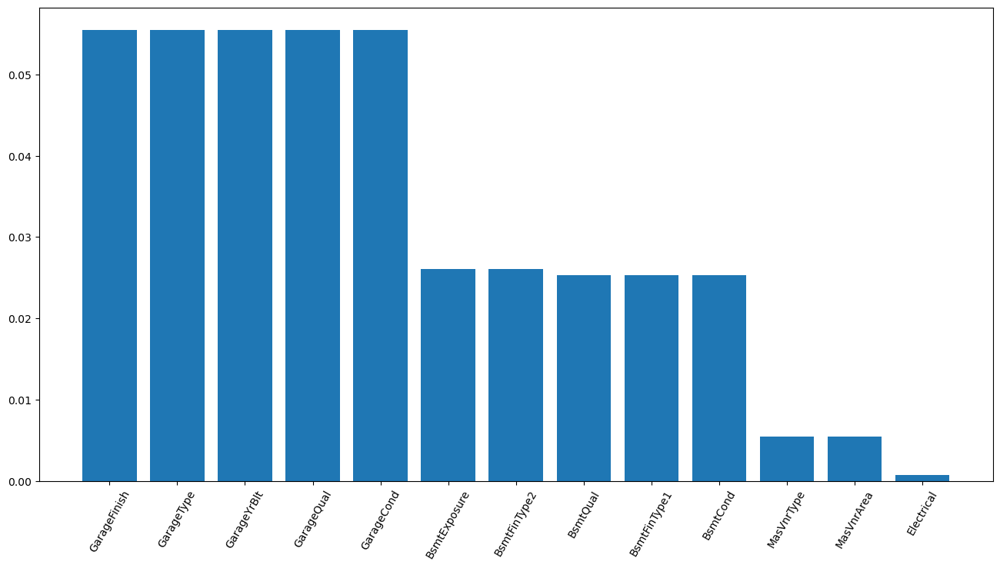

In [333]:
missing_for_impute = missing_val_detector(intermediate_df)


<font size="5">
Since we have some categorical features we need to convert them to numeric since some of the models we will be training may not be able to handle strings

</font>

In [334]:

cols = intermediate_df.columns
num_cols = intermediate_df._get_numeric_data().columns
cat_cols = list(set(cols) - set(num_cols))

for i in cat_cols:
    intermediate_df[i] = pd.factorize(intermediate_df[i])[0] + 1



/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



# Missng data imputation

In [335]:

imputer = KNNImputer(n_neighbors=10)
imputed = imputer.fit_transform(intermediate_df)
df_imputed = pd.DataFrame(imputed, columns=intermediate_df.columns)


<font size="5">
here since we can indexed data by time let's explore if we can find some trend and/or seasonality pattern so we can engineer more featurs

</font>

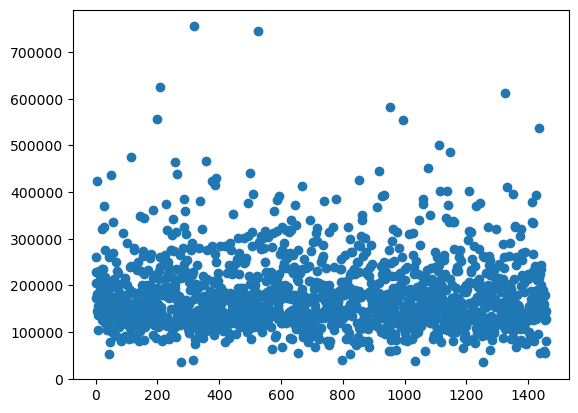

In [336]:
df_sorted = df_imputed.sort_values(by=['YrSold', 'MoSold']).reset_index()
# print(df_sorted)
plt.scatter(x=df_sorted.index,y = df_sorted.SalePrice)

In [337]:
df_trend_md = df_sorted.groupby(['YrSold', 'MoSold']).agg(
    Mean=('SalePrice', np.mean)).reset_index()
df_trend_yr = df_sorted.groupby(['YrSold']).agg(
    Mean=('SalePrice', np.mean)).reset_index()


<AxesSubplot:xlabel='YrSold', ylabel='Mean'>

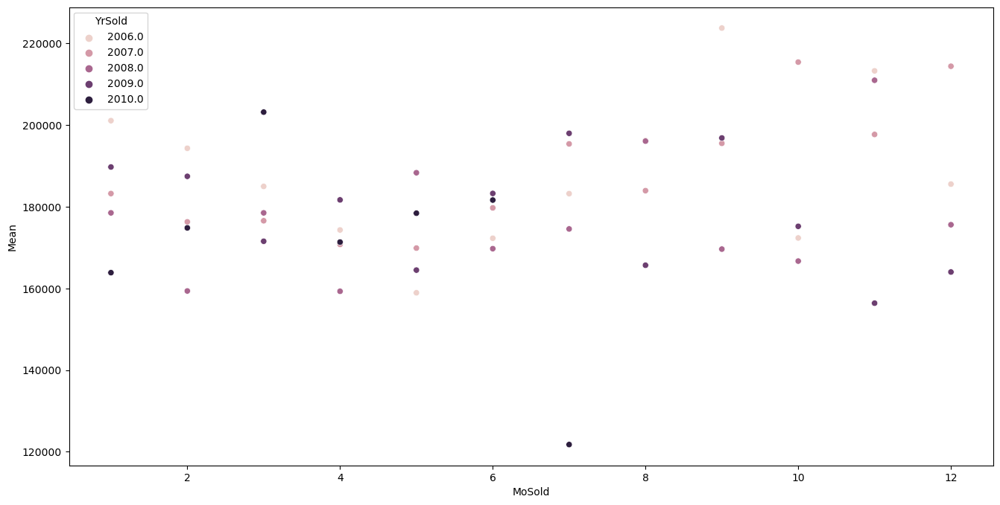

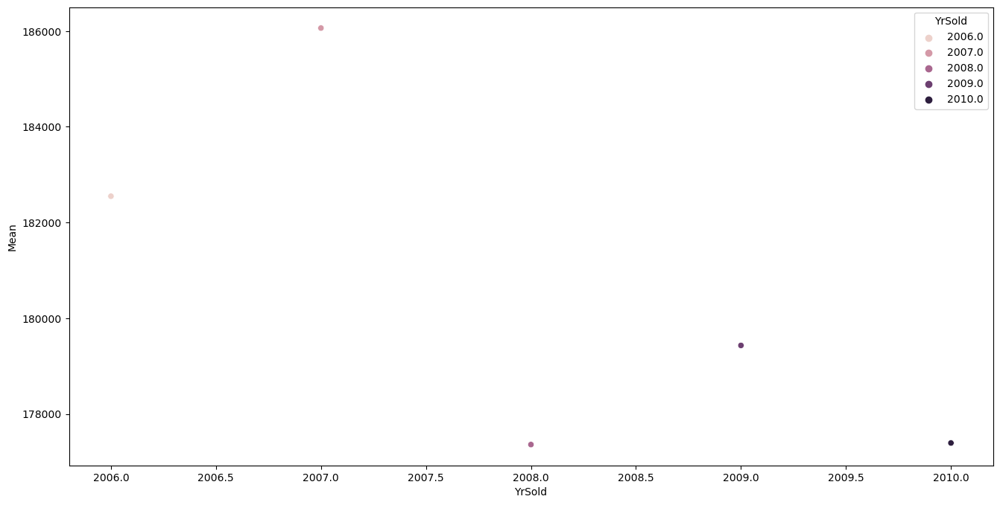

In [338]:
plt.figure(figsize=(16,8))
sns.scatterplot(x="MoSold",y="Mean",data=df_trend_md,hue="YrSold")
plt.figure(figsize=(16,8))
sns.scatterplot(x="YrSold",y="Mean",data=df_trend_yr,hue="YrSold")



# Train, Test split and Model training

In [339]:
ind = df_imputed.columns 
features =list( set(df_imputed.columns ) - set(["SalePrice"]))
y = df_imputed.loc[:,"SalePrice"].copy(deep=True)


In [340]:

X = df_imputed.loc[:,features].copy(deep = True)
X_train,X_test,y_train,y_test = train_test_split(X,y)

## LGBM Regressor

<font size="5">
Now we can proceed with training our first model. We will be using GridSearchCV for to help us search through hyperparameters.
</font>

In [341]:
import pickle # just ot save a model object

estimator = LGBMRegressor(
    objective = "tweedie",
    random_state =23
)

#define the hyperparameter space
param_dist = dict(

    max_depth = [40] ,# [20,25,40],
    n_estimators = [1000] ,#[500,1000,1500],
    learning_rate =[0.01,0.001],
    boosting = ["dart"],
    feature_fraction = [1,0.9],
    bagging_fraction = [0.9]

)

def train_model(estimator,params,pre_trained = True):
    if not pre_trained:
        optim_model = GridSearchCV(
        estimator,
        param_grid = param_dist,
        n_jobs= -1,
        cv = KFold(n_splits=5, shuffle =True),
        verbose = 0
        )
        optim_model.fit(X_train,y_train)
#         print(estimator)
        best_model = optim_model.best_estimator_

        with open("/kaggle/working/model.pkl", "wb") as f:
            pickle.dump(best_model, f)
        return(best_model)
    else:
        with open("/kaggle/working/model.pkl", "rb") as f:
            best_model = pickle.load(f)
        return (best_model)


In [342]:

best_model = train_model(estimator,param_dist,pre_trained=False) # unfortunately the file gets deleted when session expires


[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] boosting is set=dart, boosting_type=gbdt will be ignored. Current value: boosting=dart
[LightGBM] [Warning] feature_fraction is set=1, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] boosting is set=dart, boosting_type=gbdt will be ignored. Current value: boosting=dart
[LightGBM] [Warning] feature_fraction is set=1, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] boosting is set=dart, boosting_type=gbdt will be ignored. Current value: boosting=dart
[LightGBM] [Warning] feature_fraction is set=1, colsample_bytree=1.0 will be ignored.

<font size="5">
Now, we can create some object to store models and their performance so we can compare them at the end
</font>

In [343]:
from sklearn.metrics import mean_squared_error
model_perf = {}
models = {}
y_pred = best_model.predict(X_test)
score = np.sqrt(mean_squared_error(y_pred,y_test))
model_perf["LGBM - RMSE"] =score
models["LGBM"] = best_model

<font size="5">
Next lines of code demonstrate doing the hyperparameter optimization using optuna. Here we will try to use our custom loss function for the lightgbm. Later we should use the RMSE since the final evaluation is based on this metric
</font>

In [344]:
import optuna
from sklearn.metrics import make_scorer
import lightgbm as lgb
from sklearn.model_selection import cross_val_score

X, y = X_train, y_train

# Create a custom loss to be used by lightgbm
def custom_loss(y_true, y_pred):
    diff = y_true - y_pred
    grad = np.where(diff < 0, - 1.3 * diff, - diff)
    hess = np.where(diff < 0, 1.3, 1)
    return grad, hess

def objective(trial):
    
    param_grid = {
        "n_estimators": trial.suggest_int("n_estimators",100,1500,step = 300),
        "learning_rate": trial.suggest_float("learning_rate", 0.001, 1),
        "num_leaves": trial.suggest_int("num_leaves", 20, 300, step=50),
        "max_depth": trial.suggest_int("max_depth", 10, 40 ,step = 5),#,
#         "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 200, 1000, step=200),
        "lambda_l1": trial.suggest_int("lambda_l1", 0, 100, step=20),
    }

    model = lgb.LGBMRegressor(objective=custom_loss, **param_grid)

    scores = cross_val_score(model, X, y, cv=5,  n_jobs=-1)
    return np.mean(scores)








In [345]:
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=50)

[I 2023-04-23 11:55:01,979] A new study created in memory with name: no-name-11182a17-d71f-4316-aa0f-d75c0e048421
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60


[I 2023-04-23 11:55:05,786] Trial 0 finished with value: 0.86984416261819 and parameters: {'n_estimators': 100, 'learning_rate': 0.24058482871397716, 'num_leaves': 220, 'max_depth': 35, 'lambda_l1': 60}. Best is trial 0 with value: 0.86984416261819.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40


[I 2023-04-23 11:55:22,721] Trial 1 finished with value: 0.8712105235379856 and parameters: {'n_estimators': 700, 'learning_rate': 0.2293778853575581, 'num_leaves': 20, 'max_depth': 35, 'lambda_l1': 40}. Best is trial 1 with value: 0.8712105235379856.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 11:55:36,417] Trial 2 finished with value: 0.8165760375801728 and parameters: {'n_estimators': 700, 'learning_rate': 0.7093339790596606, 'num_leaves': 120, 'max_depth': 40, 'lambda_l1': 20}. Best is trial 1 with value: 0.8712105235379856.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40


[I 2023-04-23 11:55:38,861] Trial 3 finished with value: 0.8344632659780544 and parameters: {'n_estimators': 100, 'learning_rate': 0.5769478905875085, 'num_leaves': 70, 'max_depth': 10, 'lambda_l1': 40}. Best is trial 1 with value: 0.8712105235379856.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100


[I 2023-04-23 11:56:06,535] Trial 4 finished with value: 0.8689150238828379 and parameters: {'n_estimators': 700, 'learning_rate': 0.14209867507477675, 'num_leaves': 70, 'max_depth': 25, 'lambda_l1': 100}. Best is trial 1 with value: 0.8712105235379856.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60


[I 2023-04-23 11:56:17,194] Trial 5 finished with value: 0.7602456403598661 and parameters: {'n_estimators': 1300, 'learning_rate': 0.896530143253634, 'num_leaves': 70, 'max_depth': 40, 'lambda_l1': 60}. Best is trial 1 with value: 0.8712105235379856.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80


[I 2023-04-23 11:56:19,372] Trial 6 finished with value: 0.8588803750879261 and parameters: {'n_estimators': 100, 'learning_rate': 0.42250379819912215, 'num_leaves': 20, 'max_depth': 10, 'lambda_l1': 80}. Best is trial 1 with value: 0.8712105235379856.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 11:56:28,661] Trial 7 finished with value: 0.8654764742043952 and parameters: {'n_estimators': 400, 'learning_rate': 0.24380309717823018, 'num_leaves': 220, 'max_depth': 10, 'lambda_l1': 20}. Best is trial 1 with value: 0.8712105235379856.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60


[I 2023-04-23 11:56:42,216] Trial 8 finished with value: 0.836573890314931 and parameters: {'n_estimators': 400, 'learning_rate': 0.5011569540837343, 'num_leaves': 70, 'max_depth': 20, 'lambda_l1': 60}. Best is trial 1 with value: 0.8712105235379856.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80


[I 2023-04-23 11:56:45,907] Trial 9 finished with value: 0.829044663904595 and parameters: {'n_estimators': 100, 'learning_rate': 0.5616254532061276, 'num_leaves': 170, 'max_depth': 35, 'lambda_l1': 80}. Best is trial 1 with value: 0.8712105235379856.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 11:57:36,491] Trial 10 finished with value: 0.8750479428436039 and parameters: {'n_estimators': 1300, 'learning_rate': 0.04006547667088717, 'num_leaves': 270, 'max_depth': 30, 'lambda_l1': 0}. Best is trial 10 with value: 0.8750479428436039.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 11:58:25,923] Trial 11 finished with value: 0.8794752335159309 and parameters: {'n_estimators': 1300, 'learning_rate': 0.020443511225209904, 'num_leaves': 270, 'max_depth': 30, 'lambda_l1': 0}. Best is trial 11 with value: 0.8794752335159309.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 11:59:17,078] Trial 12 finished with value: 0.8779484746950192 and parameters: {'n_estimators': 1300, 'learning_rate': 0.026886709011477935, 'num_leaves': 270, 'max_depth': 25, 'lambda_l1': 0}. Best is trial 11 with value: 0.8794752335159309.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 11:59:52,134] Trial 13 finished with value: 0.8728691672480137 and parameters: {'n_estimators': 1000, 'learning_rate': 0.06870568387531936, 'num_leaves': 270, 'max_depth': 20, 'lambda_l1': 0}. Best is trial 11 with value: 0.8794752335159309.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 12:00:32,439] Trial 14 finished with value: 0.8793395105098354 and parameters: {'n_estimators': 1000, 'learning_rate': 0.021118956645189313, 'num_leaves': 220, 'max_depth': 25, 'lambda_l1': 0}. Best is trial 11 with value: 0.8794752335159309.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:01:00,398] Trial 15 finished with value: 0.8637681621095092 and parameters: {'n_estimators': 1000, 'learning_rate': 0.32457255756778103, 'num_leaves': 220, 'max_depth': 20, 'lambda_l1': 20}. Best is trial 11 with value: 0.8794752335159309.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:01:46,785] Trial 16 finished with value: 0.8682577083247913 and parameters: {'n_estimators': 1000, 'learning_rate': 0.14332318665868027, 'num_leaves': 170, 'max_depth': 30, 'lambda_l1': 20}. Best is trial 11 with value: 0.8794752335159309.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 12:02:25,657] Trial 17 finished with value: 0.880181107436519 and parameters: {'n_estimators': 1000, 'learning_rate': 0.004496679552096927, 'num_leaves': 220, 'max_depth': 30, 'lambda_l1': 0}. Best is trial 17 with value: 0.880181107436519.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40


[I 2023-04-23 12:02:50,642] Trial 18 finished with value: 0.8524785009902507 and parameters: {'n_estimators': 1300, 'learning_rate': 0.37981342419149655, 'num_leaves': 170, 'max_depth': 30, 'lambda_l1': 40}. Best is trial 17 with value: 0.880181107436519.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 12:03:20,947] Trial 19 finished with value: 0.864801075247444 and parameters: {'n_estimators': 1000, 'learning_rate': 0.1525080790587514, 'num_leaves': 270, 'max_depth': 15, 'lambda_l1': 0}. Best is trial 17 with value: 0.880181107436519.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:04:12,390] Trial 20 finished with value: 0.8817734398216478 and parameters: {'n_estimators': 1300, 'learning_rate': 0.013613282347840455, 'num_leaves': 220, 'max_depth': 30, 'lambda_l1': 20}. Best is trial 20 with value: 0.8817734398216478.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:05:02,237] Trial 21 finished with value: 0.882611875740999 and parameters: {'n_estimators': 1300, 'learning_rate': 0.009336498629923211, 'num_leaves': 220, 'max_depth': 30, 'lambda_l1': 20}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:05:54,134] Trial 22 finished with value: 0.8718030946453389 and parameters: {'n_estimators': 1300, 'learning_rate': 0.10598245345551055, 'num_leaves': 220, 'max_depth': 35, 'lambda_l1': 20}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:06:34,611] Trial 23 finished with value: 0.8699993410150293 and parameters: {'n_estimators': 1000, 'learning_rate': 0.18290959513463395, 'num_leaves': 170, 'max_depth': 30, 'lambda_l1': 20}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40


[I 2023-04-23 12:07:28,007] Trial 24 finished with value: 0.8698599062683747 and parameters: {'n_estimators': 1300, 'learning_rate': 0.11094762722490983, 'num_leaves': 120, 'max_depth': 25, 'lambda_l1': 40}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:08:05,646] Trial 25 finished with value: 0.822633964223991 and parameters: {'n_estimators': 1000, 'learning_rate': 0.0024705167709098462, 'num_leaves': 220, 'max_depth': 35, 'lambda_l1': 20}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40


[I 2023-04-23 12:08:50,071] Trial 26 finished with value: 0.8679540951648782 and parameters: {'n_estimators': 1300, 'learning_rate': 0.2097578671403279, 'num_leaves': 170, 'max_depth': 30, 'lambda_l1': 40}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 12:09:29,621] Trial 27 finished with value: 0.874561711887449 and parameters: {'n_estimators': 1000, 'learning_rate': 0.08496909606807404, 'num_leaves': 220, 'max_depth': 25, 'lambda_l1': 0}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:10:01,282] Trial 28 finished with value: 0.8615276185851043 and parameters: {'n_estimators': 1300, 'learning_rate': 0.30953074054796836, 'num_leaves': 120, 'max_depth': 40, 'lambda_l1': 20}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 12:10:42,235] Trial 29 finished with value: 0.8726562367030073 and parameters: {'n_estimators': 1000, 'learning_rate': 0.10387985809815092, 'num_leaves': 220, 'max_depth': 35, 'lambda_l1': 0}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40


[I 2023-04-23 12:11:10,079] Trial 30 finished with value: 0.8600661545046162 and parameters: {'n_estimators': 700, 'learning_rate': 0.2628380426192703, 'num_leaves': 220, 'max_depth': 30, 'lambda_l1': 40}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 12:12:02,930] Trial 31 finished with value: 0.8738943044362892 and parameters: {'n_estimators': 1300, 'learning_rate': 0.030231962008661763, 'num_leaves': 270, 'max_depth': 30, 'lambda_l1': 0}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 12:12:55,797] Trial 32 finished with value: 0.8648976506034829 and parameters: {'n_estimators': 1300, 'learning_rate': 0.17581378476997203, 'num_leaves': 270, 'max_depth': 35, 'lambda_l1': 0}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:13:46,357] Trial 33 finished with value: 0.8818534318683978 and parameters: {'n_estimators': 1300, 'learning_rate': 0.005815306967684355, 'num_leaves': 270, 'max_depth': 25, 'lambda_l1': 20}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:14:39,530] Trial 34 finished with value: 0.8680319288449312 and parameters: {'n_estimators': 1300, 'learning_rate': 0.07556215964287298, 'num_leaves': 220, 'max_depth': 25, 'lambda_l1': 20}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40


[I 2023-04-23 12:15:06,607] Trial 35 finished with value: 0.8643962027306552 and parameters: {'n_estimators': 700, 'learning_rate': 0.004590923574756951, 'num_leaves': 270, 'max_depth': 20, 'lambda_l1': 40}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:15:57,946] Trial 36 finished with value: 0.868288282573487 and parameters: {'n_estimators': 1300, 'learning_rate': 0.18649553668668598, 'num_leaves': 170, 'max_depth': 25, 'lambda_l1': 20}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:16:38,422] Trial 37 finished with value: 0.871387397879737 and parameters: {'n_estimators': 1000, 'learning_rate': 0.08730538658997475, 'num_leaves': 270, 'max_depth': 40, 'lambda_l1': 20}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40


[I 2023-04-23 12:17:05,817] Trial 38 finished with value: 0.8655645799762196 and parameters: {'n_estimators': 700, 'learning_rate': 0.23972607251000777, 'num_leaves': 220, 'max_depth': 30, 'lambda_l1': 40}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60


[I 2023-04-23 12:17:45,430] Trial 39 finished with value: 0.867708200921378 and parameters: {'n_estimators': 1300, 'learning_rate': 0.13731204875844163, 'num_leaves': 170, 'max_depth': 15, 'lambda_l1': 60}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100


[I 2023-04-23 12:18:01,874] Trial 40 finished with value: 0.8764059934958576 and parameters: {'n_estimators': 400, 'learning_rate': 0.08606080524955796, 'num_leaves': 120, 'max_depth': 25, 'lambda_l1': 100}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 12:18:50,633] Trial 41 finished with value: 0.7809941179739047 and parameters: {'n_estimators': 1300, 'learning_rate': 0.0016677943861894938, 'num_leaves': 270, 'max_depth': 30, 'lambda_l1': 0}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:19:45,173] Trial 42 finished with value: 0.8712662075264344 and parameters: {'n_estimators': 1300, 'learning_rate': 0.05885974298682505, 'num_leaves': 270, 'max_depth': 35, 'lambda_l1': 20}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 12:20:36,865] Trial 43 finished with value: 0.8702762447702138 and parameters: {'n_estimators': 1300, 'learning_rate': 0.05619676160810391, 'num_leaves': 220, 'max_depth': 30, 'lambda_l1': 0}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:21:11,113] Trial 44 finished with value: 0.8667771334422836 and parameters: {'n_estimators': 1300, 'learning_rate': 0.13013153542508307, 'num_leaves': 20, 'max_depth': 30, 'lambda_l1': 20}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 12:21:47,825] Trial 45 finished with value: 0.7421994140717614 and parameters: {'n_estimators': 1000, 'learning_rate': 0.0019870927629493293, 'num_leaves': 270, 'max_depth': 25, 'lambda_l1': 0}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 12:22:40,977] Trial 46 finished with value: 0.8734778003750957 and parameters: {'n_estimators': 1300, 'learning_rate': 0.05379240465196166, 'num_leaves': 220, 'max_depth': 35, 'lambda_l1': 0}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80


[I 2023-04-23 12:23:17,677] Trial 47 finished with value: 0.8629730360477289 and parameters: {'n_estimators': 1000, 'learning_rate': 0.14603019941712705, 'num_leaves': 270, 'max_depth': 20, 'lambda_l1': 80}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


[I 2023-04-23 12:24:04,376] Trial 48 finished with value: 0.867685514286387 and parameters: {'n_estimators': 1300, 'learning_rate': 0.21199829315497015, 'num_leaves': 220, 'max_depth': 30, 'lambda_l1': 20}. Best is trial 21 with value: 0.882611875740999.
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 1500] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 1300].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].



[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0


[I 2023-04-23 12:24:52,917] Trial 49 finished with value: 0.8763833111713686 and parameters: {'n_estimators': 1300, 'learning_rate': 0.04210641417612293, 'num_leaves': 270, 'max_depth': 25, 'lambda_l1': 0}. Best is trial 21 with value: 0.882611875740999.


In [346]:
print("Best trial:")
trial = study.best_trial
print("  Value: {}".format(trial.value))
print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))


Best trial:
  Value: 0.882611875740999
  Params: 
    n_estimators: 1300
    learning_rate: 0.009336498629923211
    num_leaves: 220
    max_depth: 30
    lambda_l1: 20


In [347]:
optuna.importance.get_param_importances(study)

OrderedDict([('learning_rate', 0.9213351276781578),
             ('n_estimators', 0.03408813108892136),
             ('max_depth', 0.026678292874452978),
             ('lambda_l1', 0.013582299618536485),
             ('num_leaves', 0.004316148739931221)])

In [348]:

# Plot parameter importances
fig = optuna.visualization.plot_param_importances(study)
fig.show(renderer="notebook")



In [349]:

fig = optuna.visualization.plot_optimization_history(study)
fig.show(renderer="notebook")



In [350]:

fig = optuna.visualization.plot_contour(study)
fig.show(renderer="notebook")



In [351]:
#recreate the model with best hyperparameters
best_lgbm =lgb.LGBMRegressor(objective=custom_loss, **trial.params).fit(X_train,y_train) # could also fit using all the training data 

y_pred = best_lgbm.predict(X_test)
score = np.sqrt(mean_squared_error(y_pred,y_test))
model_perf["LGBM_optuna - RMSE"] =score
models["LGBM_optuna"] = best_lgbm

[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20


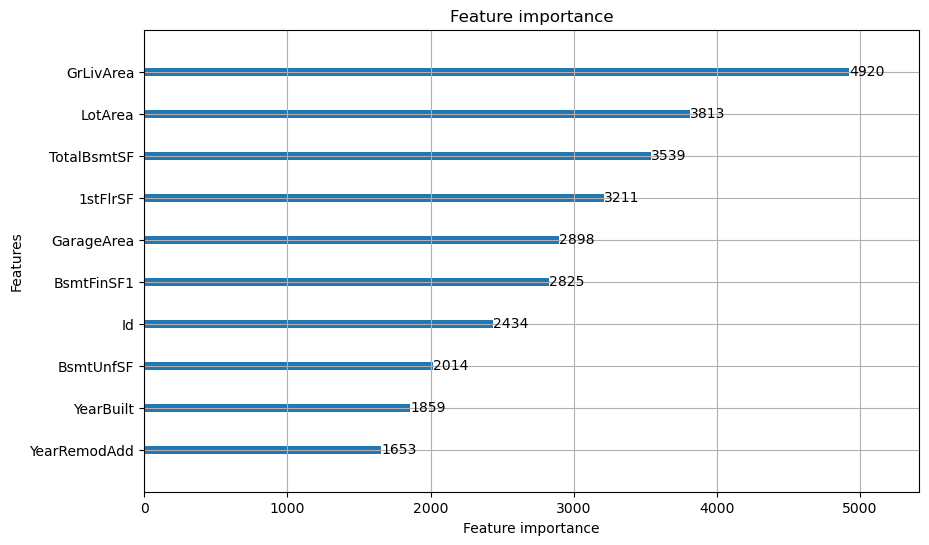

In [352]:
lgb.plot_importance(best_lgbm, max_num_features=10, figsize=(10, 6))
plt.show()

In [353]:
model_perf

{'LGBM - RMSE': 198157.51845967103, 'LGBM_optuna - RMSE': 32971.74721615445}

<font size="5">
Let's train the same model using RMSE as a Loss 
</font>

In [354]:
def RMSE(y_true, y_pred):
    rmse = np.sqrt(np.mean((y_true - y_pred) ** 2))
    grad = -2 * (y_true - y_pred) / len(y_true)
    hess = 2 / len(y_true) * np.ones(len(y_true))
    return grad, hess

# # adding learning rate annealing
# def decreasing_learning_rate(params, iteration, current_score):
#     if iteration > 50:
#         # decrease the learning rate by a factor of 0.1 for the last 50 iterations
#         params['learning_rate'] *= 0.1
#     return params

def objective(trial):
    param_grid = {
        "n_estimators": trial.suggest_int("n_estimators",100,3000,step = 300),
        "learning_rate": trial.suggest_float("learning_rate", 0.00001, 1),
        "num_leaves": trial.suggest_int("num_leaves", 20, 300, step=50),
        "max_depth": trial.suggest_int("max_depth", 10, 40 ,step = 5),#,
#         "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 200, 1000, step=200),
        "lambda_l1": trial.suggest_float("lambda_l1", 0, 10),
#         "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0, 15,step= 3)
    }

    model = lgb.LGBMRegressor(objective='root_mean_squared_error', **param_grid)
    # cv done through lgbm method
    cv_results = lgb.cv(
    params=param_grid,
    train_set=lgb.Dataset(X, label=y),
    num_boost_round=100,
#     callbacks=[lgb.reset_parameter(decreasing_learning_rate)],
#     callbacks=[lgb.reset_parameter(lambda x: decreasing_learning_rate(x, cv_results['rmse-mean'][-1]))],

    nfold=5,
    stratified=False,
    shuffle=True,
    metrics=['rmse'],
    early_stopping_rounds=10,
    verbose_eval=False,
    seed=42
    )
    print(np.min(cv_results['rmse-mean']))
    return np.min(cv_results['rmse-mean'])

    





In [355]:
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=50)

print("Best trial:")
trial = study.best_trial
print("  Value: {}".format(trial.value))
print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))




[I 2023-04-23 12:25:09,488] A new study created in memory with name: no-name-c2179967-82f4-422e-9538-cefe0de84a0c
/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [100, 3000] and step=300, but the range is not divisible by `step`. It will be replaced by [100, 2800].

/opt/conda/lib/python3.7/site-packages/optuna/distributions.py:719: UserWarning:

The distribution is specified by [20, 300] and step=50, but the range is not divisible by `step`. It will be replaced by [20, 270].

/opt/conda/lib/python3.7/site-packages/lightgbm/engine.py:573: UserWarning:

Found `n_estimators` in params. Will use it instead of argument

/opt/conda/lib/python3.7/site-packages/lightgbm/engine.py:577: UserWarning:

'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.

/opt/conda/lib/python3.7/site-packages/lightgbm/engine.py:620: U

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002801 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001884 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002788 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the o

[I 2023-04-23 12:25:16,338] Trial 0 finished with value: 27644.012047550023 and parameters: {'n_estimators': 2200, 'learning_rate': 0.025248394494336097, 'num_leaves': 170, 'max_depth': 10, 'lambda_l1': 9.914253635728521}. Best is trial 0 with value: 27644.012047550023.


27644.012047550023
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002003 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002149 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002210 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM]

[I 2023-04-23 12:25:16,901] Trial 1 finished with value: 31898.304741616557 and parameters: {'n_estimators': 700, 'learning_rate': 0.6103457564739763, 'num_leaves': 220, 'max_depth': 10, 'lambda_l1': 1.0946197675115898}. Best is trial 0 with value: 27644.012047550023.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:25:18,494] Trial 2 finished with value: 28393.604744960125 and parameters: {'n_estimators': 1000, 'learning_rate': 0.22276405713209332, 'num_leaves': 70, 'max_depth': 25, 'lambda_l1': 6.351612791112577}. Best is trial 0 with value: 27644.012047550023.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
28393.604744960125
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002270 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in 

[I 2023-04-23 12:25:19,271] Trial 3 finished with value: 30028.0996571908 and parameters: {'n_estimators': 1600, 'learning_rate': 0.40900436588633077, 'num_leaves': 70, 'max_depth': 40, 'lambda_l1': 4.141025607617524}. Best is trial 0 with value: 27644.012047550023.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
30028.0996571908
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001970 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002100 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002020 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you ca

[I 2023-04-23 12:25:38,260] Trial 4 finished with value: 27600.65030022144 and parameters: {'n_estimators': 1900, 'learning_rate': 0.009076143008796084, 'num_leaves': 120, 'max_depth': 15, 'lambda_l1': 1.0137863559934945}. Best is trial 4 with value: 27600.65030022144.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
27600.65030022144
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testi

[I 2023-04-23 12:25:38,739] Trial 5 finished with value: 29847.38566884147 and parameters: {'n_estimators': 2200, 'learning_rate': 0.4109178800312666, 'num_leaves': 20, 'max_depth': 30, 'lambda_l1': 3.467400445083828}. Best is trial 4 with value: 27600.65030022144.


29847.38566884147
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002037 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002876 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002974 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise mult

[I 2023-04-23 12:25:39,165] Trial 6 finished with value: 35854.736487893984 and parameters: {'n_estimators': 1000, 'learning_rate': 0.8538012967406239, 'num_leaves': 20, 'max_depth': 15, 'lambda_l1': 0.10048797450933566}. Best is trial 4 with value: 27600.65030022144.


35854.736487893984
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002899 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002945 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002180 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise mul

[I 2023-04-23 12:25:40,725] Trial 7 finished with value: 28073.614297556644 and parameters: {'n_estimators': 2200, 'learning_rate': 0.19236643249105298, 'num_leaves': 220, 'max_depth': 40, 'lambda_l1': 0.7872885927309203}. Best is trial 4 with value: 27600.65030022144.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:25:41,108] Trial 8 finished with value: 36948.782190255166 and parameters: {'n_estimators': 1000, 'learning_rate': 0.9086642649127633, 'num_leaves': 170, 'max_depth': 10, 'lambda_l1': 1.7759075539936908}. Best is trial 4 with value: 27600.65030022144.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:25:42,215] Trial 9 finished with value: 28840.094155217073 and parameters: {'n_estimators': 2200, 'learning_rate': 0.2987413211993274, 'num_leaves': 170, 'max_depth': 25, 'lambda_l1': 4.373102725211543}. Best is trial 4 with value: 27600.65030022144.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:25:45,767] Trial 10 finished with value: 27929.145004730854 and parameters: {'n_estimators': 100, 'learning_rate': 0.0393105728038802, 'num_leaves': 270, 'max_depth': 20, 'lambda_l1': 2.520122204097746}. Best is trial 4 with value: 27600.65030022144.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:25:51,878] Trial 11 finished with value: 27588.71044086558 and parameters: {'n_estimators': 1600, 'learning_rate': 0.03477700243255337, 'num_leaves': 120, 'max_depth': 15, 'lambda_l1': 9.10720318849764}. Best is trial 11 with value: 27588.71044086558.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
27588.71044086558
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003205 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.0

[I 2023-04-23 12:26:17,159] Trial 12 finished with value: 27567.488901171157 and parameters: {'n_estimators': 2800, 'learning_rate': 0.007557521449937717, 'num_leaves': 120, 'max_depth': 20, 'lambda_l1': 6.031916533532509}. Best is trial 12 with value: 27567.488901171157.


27567.488901171157
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002016 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001983 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002860 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of u

[I 2023-04-23 12:26:19,146] Trial 13 finished with value: 28029.15546546109 and parameters: {'n_estimators': 2800, 'learning_rate': 0.1496285923121713, 'num_leaves': 120, 'max_depth': 20, 'lambda_l1': 6.544695836776458}. Best is trial 12 with value: 27567.488901171157.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:26:21,428] Trial 14 finished with value: 28220.156892229337 and parameters: {'n_estimators': 2800, 'learning_rate': 0.13686394344602063, 'num_leaves': 70, 'max_depth': 30, 'lambda_l1': 9.442503766223385}. Best is trial 12 with value: 27567.488901171157.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:26:24,943] Trial 15 finished with value: 76909.70013554013 and parameters: {'n_estimators': 100, 'learning_rate': 0.0003529001164219725, 'num_leaves': 120, 'max_depth': 20, 'lambda_l1': 8.360708246961241}. Best is trial 12 with value: 27567.488901171157.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
76909.70013554013
[LightG

[I 2023-04-23 12:26:25,845] Trial 16 finished with value: 29078.518270895314 and parameters: {'n_estimators': 1600, 'learning_rate': 0.2742868182620816, 'num_leaves': 70, 'max_depth': 15, 'lambda_l1': 5.663081603764747}. Best is trial 12 with value: 27567.488901171157.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:26:27,870] Trial 17 finished with value: 27840.833812202898 and parameters: {'n_estimators': 2800, 'learning_rate': 0.12245484311472482, 'num_leaves': 220, 'max_depth': 30, 'lambda_l1': 7.637365984339715}. Best is trial 12 with value: 27567.488901171157.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:26:29,883] Trial 18 finished with value: 29027.317066527467 and parameters: {'n_estimators': 2500, 'learning_rate': 0.3316878742713193, 'num_leaves': 120, 'max_depth': 20, 'lambda_l1': 8.008983665465236}. Best is trial 12 with value: 27567.488901171157.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:26:32,130] Trial 19 finished with value: 27981.084943360904 and parameters: {'n_estimators': 1300, 'learning_rate': 0.11280085659761624, 'num_leaves': 170, 'max_depth': 15, 'lambda_l1': 6.854866013289996}. Best is trial 12 with value: 27567.488901171157.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:26:33,590] Trial 20 finished with value: 28104.81275892742 and parameters: {'n_estimators': 400, 'learning_rate': 0.20354822257163935, 'num_leaves': 270, 'max_depth': 35, 'lambda_l1': 5.0279923215787}. Best is trial 12 with value: 27567.488901171157.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:26:53,446] Trial 21 finished with value: 27432.14983720971 and parameters: {'n_estimators': 1900, 'learning_rate': 0.011036475505741345, 'num_leaves': 120, 'max_depth': 15, 'lambda_l1': 3.186029519246784}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
27432.14983720971
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002427 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002847 secon

[I 2023-04-23 12:26:55,996] Trial 22 finished with value: 27610.283423764566 and parameters: {'n_estimators': 1900, 'learning_rate': 0.08566879416064285, 'num_leaves': 120, 'max_depth': 15, 'lambda_l1': 3.1107652338739262}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:27:02,297] Trial 23 finished with value: 27568.302182819833 and parameters: {'n_estimators': 1300, 'learning_rate': 0.04595982445460625, 'num_leaves': 70, 'max_depth': 20, 'lambda_l1': 8.978990493245076}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:27:05,600] Trial 24 finished with value: 27768.361353096807 and parameters: {'n_estimators': 1300, 'learning_rate': 0.09258903109840197, 'num_leaves': 70, 'max_depth': 25, 'lambda_l1': 7.352902176768939}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
27768.361353096807
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of test

[I 2023-04-23 12:27:06,644] Trial 25 finished with value: 27960.932368730497 and parameters: {'n_estimators': 2500, 'learning_rate': 0.17884301541356828, 'num_leaves': 20, 'max_depth': 20, 'lambda_l1': 5.52840180619562}. Best is trial 21 with value: 27432.14983720971.


27960.932368730497
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002209 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003016 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002988 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise mul

[I 2023-04-23 12:27:09,677] Trial 26 finished with value: 27684.094447721676 and parameters: {'n_estimators': 1900, 'learning_rate': 0.0838984542977413, 'num_leaves': 70, 'max_depth': 25, 'lambda_l1': 8.751086160512225}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:27:10,397] Trial 27 finished with value: 28372.34269810083 and parameters: {'n_estimators': 2500, 'learning_rate': 0.2450125832828312, 'num_leaves': 20, 'max_depth': 20, 'lambda_l1': 8.327238555709389}. Best is trial 21 with value: 27432.14983720971.


28372.34269810083
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003169 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002814 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise mult

[I 2023-04-23 12:27:11,731] Trial 28 finished with value: 28258.58555116228 and parameters: {'n_estimators': 700, 'learning_rate': 0.16730206467722913, 'num_leaves': 70, 'max_depth': 10, 'lambda_l1': 7.216354123857563}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:27:54,161] Trial 29 finished with value: 27855.334272995773 and parameters: {'n_estimators': 1300, 'learning_rate': 0.0031194219106605563, 'num_leaves': 170, 'max_depth': 10, 'lambda_l1': 5.852778664146472}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:27:57,787] Trial 30 finished with value: 27650.020953418647 and parameters: {'n_estimators': 1900, 'learning_rate': 0.0691449651127512, 'num_leaves': 120, 'max_depth': 25, 'lambda_l1': 9.276135359903813}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
27650.020953418647
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003133 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003385 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002190 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Tota

[I 2023-04-23 12:28:57,106] Trial 31 finished with value: 60681.8415235554 and parameters: {'n_estimators': 1600, 'learning_rate': 0.00022481242714007636, 'num_leaves': 120, 'max_depth': 15, 'lambda_l1': 9.837028218743232}. Best is trial 21 with value: 27432.14983720971.


60681.8415235554
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002758 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002396 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001942 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of use

[I 2023-04-23 12:29:00,936] Trial 32 finished with value: 27793.725142026502 and parameters: {'n_estimators': 1600, 'learning_rate': 0.06796948610362857, 'num_leaves': 120, 'max_depth': 15, 'lambda_l1': 9.284844434145647}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:29:07,246] Trial 33 finished with value: 27437.700389822316 and parameters: {'n_estimators': 700, 'learning_rate': 0.048936666522383, 'num_leaves': 170, 'max_depth': 20, 'lambda_l1': 8.634859315192497}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
27437.700389822316
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003205 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warn

[I 2023-04-23 12:29:09,266] Trial 34 finished with value: 28397.800347320233 and parameters: {'n_estimators': 700, 'learning_rate': 0.1376404249693284, 'num_leaves': 220, 'max_depth': 20, 'lambda_l1': 7.855289606008875}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
28397.800347320233
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001909 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise mult

[I 2023-04-23 12:29:12,462] Trial 35 finished with value: 27736.406442289102 and parameters: {'n_estimators': 400, 'learning_rate': 0.0655304835322715, 'num_leaves': 170, 'max_depth': 20, 'lambda_l1': 9.983321954255873}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:29:13,839] Trial 36 finished with value: 28642.10776187717 and parameters: {'n_estimators': 1000, 'learning_rate': 0.23951990402951895, 'num_leaves': 170, 'max_depth': 25, 'lambda_l1': 6.266568126045266}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
28642.10776187717
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002752 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002171 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col

[I 2023-04-23 12:29:14,513] Trial 37 finished with value: 29604.091099255536 and parameters: {'n_estimators': 700, 'learning_rate': 0.36048701050023957, 'num_leaves': 70, 'max_depth': 10, 'lambda_l1': 4.661653660954743}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:29:16,361] Trial 38 finished with value: 27949.32774871018 and parameters: {'n_estimators': 400, 'learning_rate': 0.18522898039003807, 'num_leaves': 220, 'max_depth': 30, 'lambda_l1': 3.922503681691736}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
27949.32774871018
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[Li

[I 2023-04-23 12:29:17,158] Trial 39 finished with value: 31120.298161652718 and parameters: {'n_estimators': 1000, 'learning_rate': 0.485134805123012, 'num_leaves': 70, 'max_depth': 25, 'lambda_l1': 6.961313277389584}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
31120.298161652718
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001888 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001998 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memor

[I 2023-04-23 12:29:18,452] Trial 40 finished with value: 28881.272324958136 and parameters: {'n_estimators': 1300, 'learning_rate': 0.23186829729577332, 'num_leaves': 170, 'max_depth': 20, 'lambda_l1': 7.577672768982922}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
28881.272324958136
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of test

[I 2023-04-23 12:29:23,637] Trial 41 finished with value: 27676.71951555355 and parameters: {'n_estimators': 1600, 'learning_rate': 0.04278243193287165, 'num_leaves': 120, 'max_depth': 15, 'lambda_l1': 8.916291623385895}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:29:27,488] Trial 42 finished with value: 27435.580498053645 and parameters: {'n_estimators': 2200, 'learning_rate': 0.04956084067256773, 'num_leaves': 120, 'max_depth': 15, 'lambda_l1': 8.637340213538955}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
27435.580498053645
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002127 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002043 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise mult

[I 2023-04-23 12:29:29,528] Trial 43 finished with value: 27934.240038687236 and parameters: {'n_estimators': 2200, 'learning_rate': 0.11120440651072899, 'num_leaves': 170, 'max_depth': 15, 'lambda_l1': 8.412055149910053}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:29:35,309] Trial 44 finished with value: 27615.41229908443 and parameters: {'n_estimators': 2500, 'learning_rate': 0.038592479500343224, 'num_leaves': 120, 'max_depth': 20, 'lambda_l1': 8.066013351486388}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:29:36,651] Trial 45 finished with value: 28000.643289343552 and parameters: {'n_estimators': 1900, 'learning_rate': 0.1538670689686344, 'num_leaves': 120, 'max_depth': 10, 'lambda_l1': 9.654708098613884}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
28000.643289343552
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003458 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007392 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise mult

[I 2023-04-23 12:29:42,944] Trial 46 finished with value: 27561.09522863627 and parameters: {'n_estimators': 2200, 'learning_rate': 0.038787915868036024, 'num_leaves': 70, 'max_depth': 20, 'lambda_l1': 8.766935546925522}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
27561.09522863627
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001989 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002125 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi

[I 2023-04-23 12:29:44,758] Trial 47 finished with value: 28089.192464656237 and parameters: {'n_estimators': 2200, 'learning_rate': 0.11673339579034085, 'num_leaves': 120, 'max_depth': 15, 'lambda_l1': 8.586990752009955}. Best is trial 21 with value: 27432.14983720971.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2023-04-23 12:29:55,069] Trial 48 finished with value: 27230.368630266756 and parameters: {'n_estimators': 2200, 'learning_rate': 0.013418829981144912, 'num_leaves': 20, 'max_depth': 20, 'lambda_l1': 7.807288881139424}. Best is trial 48 with value: 27230.368630266756.


27230.368630266756
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002174 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002875 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of used features: 68
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002052 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3251
[LightGBM] [Info] Number of data points in the train set: 876, number of u

[I 2023-04-23 12:29:55,966] Trial 49 finished with value: 28080.83341228855 and parameters: {'n_estimators': 2200, 'learning_rate': 0.20417907669334628, 'num_leaves': 20, 'max_depth': 15, 'lambda_l1': 9.529116769279184}. Best is trial 48 with value: 27230.368630266756.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
28080.83341228855
Best trial:
  Value: 27230.368630266756
  Params: 
    n_estimators: 2200
    learning_rate: 0.013418829981144912
    num_leaves: 20
    max_depth: 20
    lambda_l1: 7.807288881139424


In [356]:
optuna.importance.get_param_importances(study)


OrderedDict([('learning_rate', 0.9337331634185906),
             ('lambda_l1', 0.039635493231880696),
             ('n_estimators', 0.019203992624619356),
             ('num_leaves', 0.006451107564025064),
             ('max_depth', 0.0009762431608842764)])

In [357]:
# Plot parameter importances
fig = optuna.visualization.plot_param_importances(study)
fig.show(renderer="notebook")


fig = optuna.visualization.plot_optimization_history(study)
fig.show(renderer="notebook")


fig = optuna.visualization.plot_contour(study)
fig.show(renderer="notebook")



In [358]:
rmse_lgbm =lgb.LGBMRegressor(objective=RMSE, **trial.params).fit(X_train,y_train)

y_pred = rmse_lgbm.predict(X_test)
score = np.sqrt(mean_squared_error(y_pred,y_test))
model_perf["LGBM_optuna_RMSE - RMSE"] =score
models["LGBM_optuna_RMSE"] = rmse_lgbm

[LightGBM] [Warning] lambda_l1 is set=7.807288881139424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.807288881139424


In [359]:
model_perf

{'LGBM - RMSE': 198157.51845967103,
 'LGBM_optuna - RMSE': 32971.74721615445,
 'LGBM_optuna_RMSE - RMSE': 32299.691027445842}

<font size="5">
 Now, let's train multiple models and see which one of them performs the best. For this purpose we will use sklearn's pipeline and GridSeatchCV, the best model will be add with it's performance metric to our list of models for final comparison
   
</font>

## LASSO , ELASTIC NET , BAYESIAN RIDGE, SVR and Bernoulli Restricted Boltzmann Machine 

In [360]:
from sklearn.pipeline import Pipeline
from sklearn.linear_model import Lasso, ElasticNet, BayesianRidge
from sklearn.svm import SVR
from sklearn.neural_network import BernoulliRBM

pipe = Pipeline(steps=[('estimator', Lasso())])

params_grid = [{
                'estimator':[Lasso()],
                'estimator__alpha': [1,0.1,0.01],
                },
                {
                'estimator': [ElasticNet()],
                'estimator__alpha': [0.3,0.1,0.01],
                'estimator__l1_ratio': [1,0.5,0.1],
                },
               {'estimator':[BayesianRidge()],
                'estimator__alpha_1':[1,0.1,0.01],
                'estimator__alpha_2':[1,0.1,0.01],
                'estimator__lambda_1':[0.5,0.1],
                'estimator__lambda_2':[0.5,0.1]
               },
                {'estimator':[SVR()],
                'estimator__kernel':["poly", "rbf", "sigmoid"],
                'estimator__degree':[3],#range(1,6,2),
                'estimator__epsilon':[0.1,0.01]
               },
                {'estimator':[BernoulliRBM()],
                'estimator__n_components':[128],#range(128,128*2,128),
                'estimator__learning_rate':[0.05],#[0.05,0.001],
                'estimator__batch_size':[256],
                'estimator__n_iter': [2000]
               }
    
              ]

grid = GridSearchCV(pipe, params_grid)
optim_model = GridSearchCV(
        pipe,
        param_grid = params_grid,
        n_jobs= -1,
        cv = KFold(n_splits=5, shuffle =True),
        verbose = 1
        )
optim_model.fit(X_train,y_train)
# print(estimator)
model_object = optim_model


Fitting 5 folds for each of 55 candidates, totalling 275 fits


/opt/conda/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.886e+11, tolerance: 5.477e+08

/opt/conda/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.034e+11, tolerance: 5.722e+08

/opt/conda/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.670e+11, tolerance: 5.295e+08

/opt/conda/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent

In [361]:
best_estimator = model_object.best_estimator_  # best model out of all

In [362]:
y_pred = best_estimator.predict(X_test)
score = np.sqrt(mean_squared_error(y_pred,y_test))
model_perf["{}".format(best_estimator.named_steps["estimator"])] =score
models["{}".format(best_estimator.named_steps["estimator"])] = best_estimator

In [363]:
model_perf

{'LGBM - RMSE': 198157.51845967103,
 'LGBM_optuna - RMSE': 32971.74721615445,
 'LGBM_optuna_RMSE - RMSE': 32299.691027445842,
 'ElasticNet(alpha=0.3)': 38765.65425530845}

# NN

<font size="5">
    As a final set of the models we will try to use tensorflow to build a NN. First we will build a simple one and then we will use optuna to optimize hyperparameters and reduce the loss we are obtaining from the model
</font>

In [364]:
import tensorflow as tf

In [60]:
X_t,X_val,y_t,y_val = train_test_split(X_train,y_train)

In [61]:

input_shape = X_t.shape[1:]

model_simple = tf.keras.Sequential([
 
    tf.keras.layers.Dense(units=64, activation='relu',
                          input_shape=input_shape),
    tf.keras.layers.Dense(units=32, activation='relu'),
    tf.keras.layers.Dense(units=1)
])
model_simple.summary()

Model: "sequential_158"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_1579 (Dense)          (None, 64)                4864      
                                                                 
 dense_1580 (Dense)          (None, 32)                2080      
                                                                 
 dense_1581 (Dense)          (None, 1)                 33        
                                                                 
Total params: 6,977
Trainable params: 6,977
Non-trainable params: 0
_________________________________________________________________


In [62]:
model_simple.compile("adam","mae", metrics=["mse"])

In [63]:
losses = model_simple.fit(X_t, y_t,
 
                   validation_data=(X_val, y_val),
                   batch_size=256,
                   epochs=500
 
                   )

Epoch 1/500
4/4 [==============================] - 1s 55ms/step - loss: 180484.1719 - mse: 39043207168.0000 - val_loss: 179854.1875 - val_mse: 38083612672.0000
Epoch 2/500
4/4 [==============================] - 0s 12ms/step - loss: 180483.5781 - mse: 39042990080.0000 - val_loss: 179853.5938 - val_mse: 38083399680.0000
Epoch 3/500
4/4 [==============================] - 0s 13ms/step - loss: 180482.9688 - mse: 39042768896.0000 - val_loss: 179853.0000 - val_mse: 38083182592.0000
Epoch 4/500
4/4 [==============================] - 0s 13ms/step - loss: 180482.3594 - mse: 39042547712.0000 - val_loss: 179852.3750 - val_mse: 38082961408.0000
Epoch 5/500
4/4 [==============================] - 0s 12ms/step - loss: 180481.7188 - mse: 39042314240.0000 - val_loss: 179851.6875 - val_mse: 38082715648.0000
Epoch 6/500
4/4 [==============================] - 0s 12ms/step - loss: 180481.0469 - mse: 39042064384.0000 - val_loss: 179851.0000 - val_mse: 38082453504.0000
Epoch 7/500
4/4 [=======================

<AxesSubplot:>

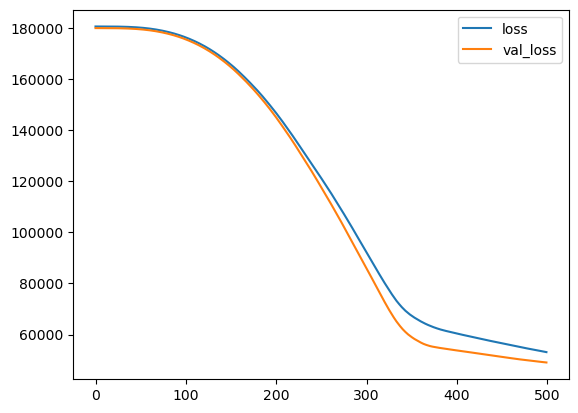

In [64]:

loss_df = pd.DataFrame(losses.history)

# plot it to visualize our model training
loss_df.loc[:,['loss','val_loss']].plot()

In [65]:
y_pred = model_simple.predict(X_test)
print(y_pred.shape)
print((y_test.shape))
score = np.sqrt(mean_squared_error(y_pred[:, 0]
,y_test))
print(score)
model_perf["TF model_simple"] =score
models["TF_simple"] = model_simple

12/12 [==============================] - 0s 1ms/step
(365, 1)
(365,)
241954502.39704087


In [87]:
import optuna
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.metrics import RootMeanSquaredError
import numpy as np


scaler = StandardScaler()
# scale the X_train
X_train =  scaler.fit_transform(X_train)
X_val =  scaler.fit_transform(X_val)

def objective(trial):
    # Define hyperparameters to optimize
    num_layers = trial.suggest_int("num_layers", 0, 16)
    num_layers_2 = trial.suggest_int("num_layers_2", 0, 16)
    num_neurons = trial.suggest_int("num_neurons", 2, 128)
    num_neurons_2 = trial.suggest_int("num_neurons_2", 2, 128)
    num_neurons_3 = trial.suggest_int("num_neurons_3", 2, 128)
    num_neurons_4 = trial.suggest_int("num_neurons_4", 2, 128)
    activation = trial.suggest_categorical("activation", ["relu", "sigmoid", "tanh","linear"])
    activation_2 = trial.suggest_categorical("activation_2", ["relu", "sigmoid", "tanh","linear"])
    activation_3 = trial.suggest_categorical("activation_3", ["relu", "sigmoid", "tanh","linear"])
    activation_4 = trial.suggest_categorical("activation_4", ["relu", "sigmoid", "tanh","linear"])
    batch_size = trial.suggest_categorical('batch_size', [8,16, 32, 64, 128, 256])
    lr = trial.suggest_float('learning_rate', 1e-5, 1e-1, log=True)
#     dropout1 =trial.suggest_float('dropout1', 0, 0.3)
#     dropout2 =trial.suggest_float('dropout2', 0, 0.3)
    dropout3 =trial.suggest_float('dropout3', 0, 0.3)


    # Create model
    model = keras.Sequential([
        layers.Dense(units=num_neurons, activation=activation, input_shape=input_shape),
#         layers.Dropout(dropout1),
        layers.Dense(units=num_neurons_2, activation=activation_2),
#         layers.Dropout(dropout2),
#         layers.BatchNormalization()
        layers.Dense(units=64, activation="linear"),
        layers.Dense(units=32, activation="relu"),
        layers.Dense(units=16, activation="linear"),

    ])
    
     # Add hidden layers based on the hyperparams 
    for i in range(num_layers):
        model.add(
            layers.Dense(
                num_neurons_3,
                activation=activation_3
#                 kernel_regularizer=keras.regularizers.L1L2(l1=0.0001, l2=0.0001),
            )
        )
    for i in range(num_layers_2):

        model.add(layers.Dropout(dropout3))
        model.add(
            layers.Dense(
                num_neurons_4,
                activation=activation_4
#                 kernel_regularizer=keras.regularizers.L1L2(l1=0.0001, l2=0.0001),
            ))
    model.add(layers.Dense(units=1, activation='linear'))
    
    # define the optimized
    optimizer = keras.optimizers.Adam(learning_rate=lr)
    model.compile(optimizer=optimizer, loss="mae", metrics=["mse"])

    # define the callbacks for early stopping and learning rate annealing
    annealer = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', patience=5, factor=0.3, verbose=0)
    early_stop = keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, verbose=0, restore_best_weights=True)
    
    # train the model
    history = model.fit(X_train, y_train, epochs=100, batch_size=batch_size, validation_data=(X_val, y_val),
                        callbacks=[annealer, early_stop], verbose=0)

    # Evaluate model
    loss = history.history["val_loss"][-1]

    return loss





In [88]:
# create a optuna study
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=50)

print("Number of finished trials: ", len(study.trials))
print("Best trial:")
trial = study.best_trial
print("  Value: ", trial.value)
print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))




[I 2023-04-24 14:20:50,106] A new study created in memory with name: no-name-66940fab-e217-47ff-8dbc-4cfae2126898
[I 2023-04-24 14:21:34,994] Trial 0 finished with value: 179173.734375 and parameters: {'num_layers': 0, 'num_layers_2': 11, 'num_neurons': 2, 'num_neurons_2': 99, 'num_neurons_3': 7, 'num_neurons_4': 100, 'activation': 'sigmoid', 'activation_2': 'tanh', 'activation_3': 'sigmoid', 'activation_4': 'tanh', 'batch_size': 32, 'learning_rate': 0.0018871802168936808, 'dropout3': 0.0778431462262202}. Best is trial 0 with value: 179173.734375.
[I 2023-04-24 14:21:59,266] Trial 1 finished with value: 179833.671875 and parameters: {'num_layers': 5, 'num_layers_2': 8, 'num_neurons': 80, 'num_neurons_2': 115, 'num_neurons_3': 16, 'num_neurons_4': 111, 'activation': 'sigmoid', 'activation_2': 'linear', 'activation_3': 'relu', 'activation_4': 'sigmoid', 'batch_size': 64, 'learning_rate': 0.00011387009702739368, 'dropout3': 0.01922027833019967}. Best is trial 0 with value: 179173.734375.


Number of finished trials:  50
Best trial:
  Value:  5329.056640625
  Params: 
    num_layers: 2
    num_layers_2: 4
    num_neurons: 122
    num_neurons_2: 33
    num_neurons_3: 25
    num_neurons_4: 124
    activation: relu
    activation_2: relu
    activation_3: tanh
    activation_4: linear
    batch_size: 32
    learning_rate: 0.0024146165176926254
    dropout3: 0.016904637210254814


In [89]:
# Retrain model with best hyperparameters
model = keras.Sequential([
    layers.Dense(units=trial.params["num_neurons"], activation=trial.params["activation"], input_shape=input_shape),
#     layers.Dropout(trial.params["dropout1"]),
    layers.Dense(units=trial.params["num_neurons_2"], activation=trial.params["activation_2"]),
#     layers.Dropout(trial.params["dropout2"]),
#     layers.BatchNormalization(),
    layers.Dense(units=64, activation="linear"),
    layers.Dense(units=32, activation="relu"),
    layers.Dense(units=16, activation="linear"),

])

 # Add hidden layers based on the hyperparams 
for i in range(trial.params["num_layers"]):
    model.add(
        layers.Dense(
            trial.params["num_neurons_3"],
            activation=trial.params["activation_3"]
#             kernel_regularizer=keras.regularizers.L1L2(l1=0.0001, l2=0.00001),
        )
    )
for i in range(trial.params["num_layers_2"]):

    model.add(layers.Dropout(trial.params["dropout3"]))
    model.add(
        layers.Dense(
            trial.params["num_neurons_4"],
            activation=trial.params["activation_4"]
#             kernel_regularizer=keras.regularizers.L1L2(l1=0.0001, l2=0.00001),
        ))
model.add(layers.Dense(units=1, activation='linear'))
# defining these two outside the function - proabably better to do it once before objective
annealer = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', patience=5, factor=0.95, verbose=0)
early_stop = keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, verbose=0, restore_best_weights=True)

optimizer = keras.optimizers.Adam(learning_rate=trial.params["learning_rate"])
model.compile(optimizer=optimizer, loss="mae", metrics=["mse"])
# refit the model using best hyperparams - could use the full training set
history = model.fit(X_train, y_train, epochs=150, batch_size=trial.params["batch_size"], validation_data=(X_val, y_val),
                    callbacks=[annealer, early_stop], verbose=0)



In [90]:


# Plot parameter importances
fig = optuna.visualization.plot_param_importances(study)
fig.show(renderer="notebook")

# plot objective and trials
fig = optuna.visualization.plot_optimization_history(study)
fig.show(renderer="notebook")


# plot to get some idea obout contours of the hyperparameter space
fig = optuna.visualization.plot_contour(study)
fig.show(renderer="notebook")



<AxesSubplot:>

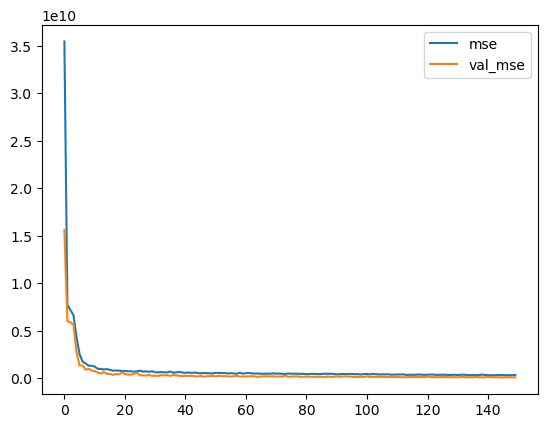

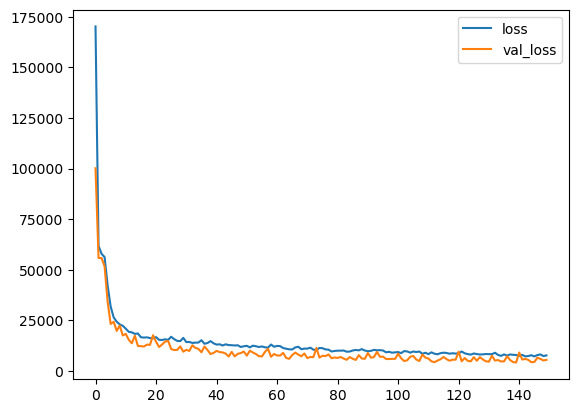

In [91]:
loss_df = pd.DataFrame(history.history)

loss_df.loc[:,['mse','val_mse']].plot()
loss_df.loc[:,['loss','val_loss']].plot()


<font size= 4 >
Perhaps trying a little more epochs to train the NN -- let's try to refit the model -- also increasing the patience of the early stop 
 

In [92]:
# Retrain model with best hyperparameters
model2 = keras.Sequential([
    layers.Dense(units=trial.params["num_neurons"], activation=trial.params["activation"], input_shape=input_shape),
#     layers.Dropout(trial.params["dropout1"]),
    layers.Dense(units=trial.params["num_neurons_2"], activation=trial.params["activation_2"]),
#     layers.Dropout(trial.params["dropout2"]),
#     layers.BatchNormalization(),
    layers.Dense(units=64, activation="linear"),
    layers.Dense(units=32, activation="relu"),
    layers.Dense(units=16, activation="linear"),

])

 # Add hidden layers based on the hyperparams 
for i in range(trial.params["num_layers"]):
    model2.add(
        layers.Dense(
            trial.params["num_neurons_3"],
            activation=trial.params["activation_3"]
#             kernel_regularizer=keras.regularizers.L1L2(l1=0.001, l2=0.00001),
        )
    )
for i in range(trial.params["num_layers_2"]):

    model2.add(layers.Dropout(trial.params["dropout3"]))
    model2.add(
        layers.Dense(
            trial.params["num_neurons_4"],
            activation=trial.params["activation_4"]
#             kernel_regularizer=keras.regularizers.L1L2(l1=0.001, l2=0.00001),
        ))
model2.add(layers.Dense(units=1, activation='linear'))

annealer = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', patience=5, factor=0.95, verbose=0)
early_stop = keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, verbose=0, restore_best_weights=True)

optimizer = keras.optimizers.Adam(learning_rate=trial.params["learning_rate"])
model2.compile(optimizer=optimizer, loss="mae", metrics=["mse"])
history = model2.fit(X_train, y_train, epochs=150, batch_size=trial.params["batch_size"], validation_data=(X_val, y_val),
                    callbacks=[annealer, early_stop], verbose=1)

Epoch 1/150
35/35 [==============================] - 3s 11ms/step - loss: 168228.1250 - mse: 34867834880.0000 - val_loss: 88772.7188 - val_mse: 13262822400.0000 - lr: 0.0024
Epoch 2/150
35/35 [==============================] - 0s 5ms/step - loss: 60822.4766 - mse: 7246820352.0000 - val_loss: 55826.2344 - val_mse: 5931225088.0000 - lr: 0.0024
Epoch 3/150
35/35 [==============================] - 0s 5ms/step - loss: 56873.2617 - mse: 6791430144.0000 - val_loss: 56950.6328 - val_mse: 6595532800.0000 - lr: 0.0024
Epoch 4/150
35/35 [==============================] - 0s 5ms/step - loss: 56400.5156 - mse: 6855371264.0000 - val_loss: 56603.0078 - val_mse: 5737028096.0000 - lr: 0.0024
Epoch 5/150
35/35 [==============================] - 0s 5ms/step - loss: 56942.9922 - mse: 6681106432.0000 - val_loss: 55836.3008 - val_mse: 5867812864.0000 - lr: 0.0024
Epoch 6/150
35/35 [==============================] - 0s 5ms/step - loss: 56459.9648 - mse: 6751571968.0000 - val_loss: 55936.3867 - val_mse: 61255

<AxesSubplot:>

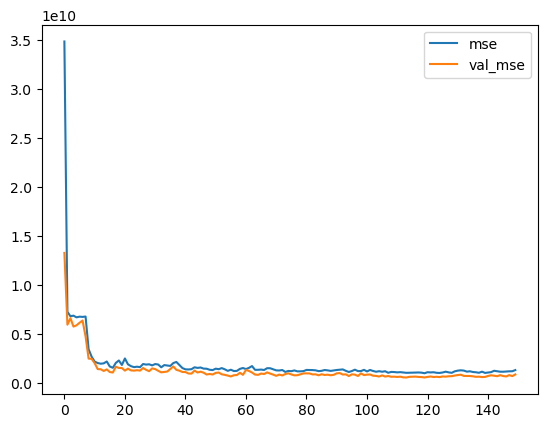

In [93]:
loss_df = pd.DataFrame(history.history)

loss_df.loc[:,['mse','val_mse']].plot()


In [94]:
models["TF"] = best_estimator

In [95]:
y_pred = model.predict(X_test)
print(y_pred.shape)
print((y_test.shape))
score = np.sqrt(mean_squared_error(y_pred[:, 0]
,y_test))
print(score)
model_perf["TF model"] =score
models["TF"] = model

12/12 [==============================] - 0s 2ms/step
(365, 1)
(365,)
223167.97187735577


In [96]:
model_perf

{'LGBM - RMSE': 198157.51845967103,
 'LGBM_optuna - RMSE': 32971.74721615445,
 'LGBM_optuna_RMSE - RMSE': 32299.691027445842,
 'ElasticNet(alpha=0.3)': 38765.65425530845,
 'TF model': 223167.97187735577,
 'TF model_simple': 241954502.39704087}

Shape of the df : (1459, 75)
         3SsnPorch   BsmtFinSF2     1stFlrSF   MasVnrArea       MiscVal  \
count  1459.000000  1458.000000  1459.000000  1444.000000   1459.000000   
mean      1.794380    52.619342  1156.534613   100.709141     58.167923   
std      20.207842   176.753926   398.165820   177.625900    630.806978   
min       0.000000     0.000000   407.000000     0.000000      0.000000   
25%       0.000000     0.000000   873.500000     0.000000      0.000000   
50%       0.000000     0.000000  1079.000000     0.000000      0.000000   
75%       0.000000     0.000000  1382.500000   164.000000      0.000000   
max     360.000000  1526.000000  5095.000000  1290.000000  17000.000000   

       TotalBsmtSF  LowQualFinSF  Fireplaces   BsmtFinSF1       MoSold  ...  \
count  1458.000000   1459.000000  1459.00000  1458.000000  1459.000000  ...   
mean   1046.117970      3.543523     0.58122   439.203704     6.104181  ...   
std     442.898624     44.043251     0.64742   455.268042 

/opt/conda/lib/python3.7/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



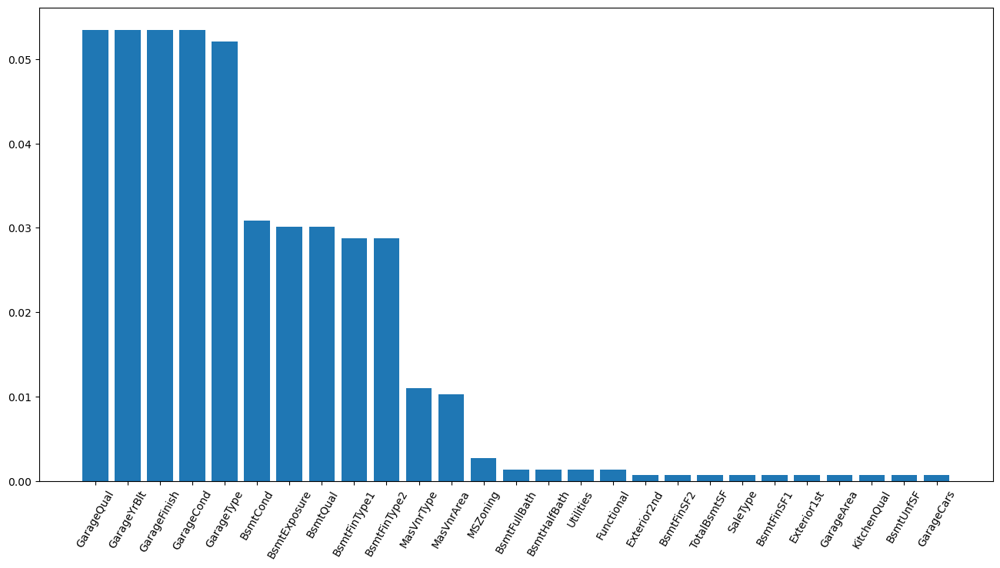

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [97]:
data_test = pd.read_csv("/kaggle/input/house-prices-advanced-regression-techniques/test.csv")

data_test["FireplaceQu"].loc[data_test["FireplaceQu"].isna()] =  "no"
over10_missing = over10_missing[over10_missing!="FireplaceQu"]
valid_columns = list(set(data_test.columns)- set(over10_missing))
intermediate_df_test = data_test[valid_columns]
missing_for_impute = missing_val_detector(intermediate_df_test)
cols = intermediate_df_test.columns
num_cols = intermediate_df_test._get_numeric_data().columns
cat_cols = list(set(cols) - set(num_cols))

for i in cat_cols:
    intermediate_df_test[i] = pd.factorize(intermediate_df_test[i])[0] + 1


imputer = KNNImputer(n_neighbors=10)
imputed = imputer.fit_transform(intermediate_df_test)
df_imputed_test = pd.DataFrame(imputed, columns=intermediate_df_test.columns)


In [98]:
models

{'LGBM': LGBMRegressor(bagging_fraction=0.9, boosting='dart', feature_fraction=0.9,
               learning_rate=0.01, max_depth=40, n_estimators=1000,
               objective='tweedie', random_state=23),
 'LGBM_optuna': LGBMRegressor(lambda_l1=20, learning_rate=0.009336498629923211, max_depth=30,
               n_estimators=1300, num_leaves=220,
               objective=<function custom_loss at 0x717b9dfd6ef0>),
 'LGBM_optuna_RMSE': LGBMRegressor(lambda_l1=7.807288881139424, learning_rate=0.013418829981144912,
               max_depth=20, n_estimators=2200, num_leaves=20,
               objective=<function RMSE at 0x717b9a26f9e0>),
 'ElasticNet(alpha=0.3)': Pipeline(steps=[('estimator', ElasticNet(alpha=0.3))]),
 'TF': <keras.engine.sequential.Sequential at 0x717b3f6b2c10>,
 'TF_simple': <keras.engine.sequential.Sequential at 0x717b3eb685d0>}

In [99]:
pred_submit = models["LGBM_optuna_RMSE"].predict(df_imputed_test)

In [104]:
pred_tf = models["TF"].predict(X_test)
pred_lgbm = models["LGBM_optuna_RMSE"].predict(X_test)
pred_en = models["TF_simple"].predict(X_test)

12/12 [==============================] - 0s 2ms/step


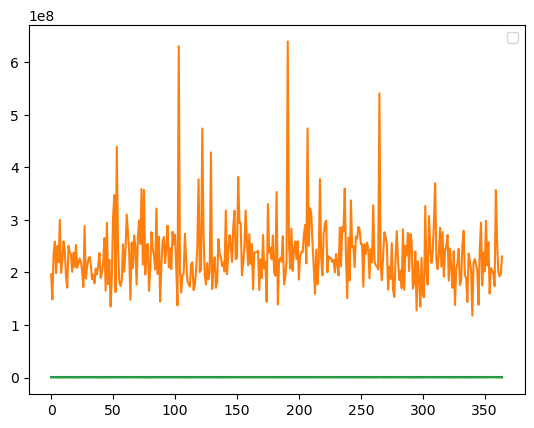

In [105]:
plt.plot(range(X_test.shape[0]),pred_tf)
# plt.plot(range(X_test.shape[0]),pred_lgbm)
plt.plot(range(X_test.shape[0]),pred_en)
plt.plot(range(X_test.shape[0]),y_test)
plt.legend()

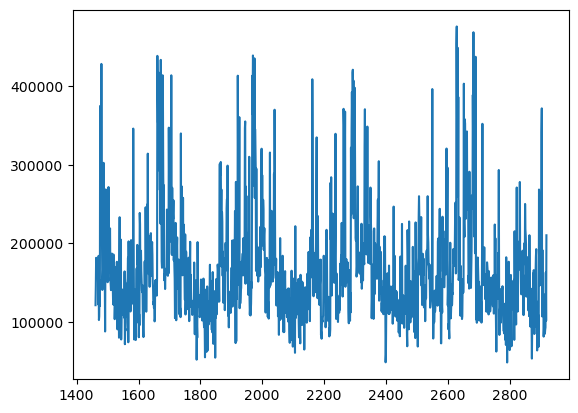

In [103]:
submission = pd.DataFrame({"id":data_test["Id"],"SalePrice":pred_submit})
plt.plot(submission2["id"],submission2["SalePrice"])

In [24]:

submission.to_csv('submission3.csv', index=False)
